In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from data_preparation_utils import *

### Excel data

In [2]:
df_free_allowances_au = get_allocation_over_years(austrian=True)
df_free_allowances_melted_au = get_allocation_melted(df_free_allowances_au)

df_free_allowances_eu = get_allocation_over_years(austrian=False)
df_free_allowances_melted_eu = get_allocation_melted(df_free_allowances_eu)

In [3]:
df_verified_allocations_total_year_au = get_totals_by_year(df_free_allowances_melted_au)
df_verified_allocations_total_year_eu = get_totals_by_year(df_free_allowances_melted_eu)

df_free_allowances_melted_au = df_free_allowances_melted_au.merge(df_verified_allocations_total_year_au, on='year', how='left')
df_free_allowances_melted_eu = df_free_allowances_melted_eu.merge(df_verified_allocations_total_year_eu, on='year', how='left')

df_free_allowances_melted_au['ALLOCATION_PERCENT'] = df_free_allowances_melted_au['ALLOCATION_'] / df_free_allowances_melted_au['ALLOCATION_TOTAL']
df_free_allowances_melted_au['VERIFIED_EMISSIONS_PERCENT'] = df_free_allowances_melted_au['VERIFIED_EMISSIONS_'] / df_free_allowances_melted_au['VERIFIED_EMISSIONS_TOTAL']

df_free_allowances_melted_eu['ALLOCATION_PERCENT'] = df_free_allowances_melted_eu['ALLOCATION_'] / df_free_allowances_melted_eu['ALLOCATION_TOTAL']
df_free_allowances_melted_eu['VERIFIED_EMISSIONS_PERCENT'] = df_free_allowances_melted_eu['VERIFIED_EMISSIONS_'] / df_free_allowances_melted_eu['VERIFIED_EMISSIONS_TOTAL']

In [4]:

fig = px.violin(df_free_allowances_melted_au, x="year", y="ALLOCATION_PERCENT", title='Free allocated allowances, % of Austria total allocated allowances over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

In [5]:

fig = px.violin(df_free_allowances_melted_au, x="year", y="VERIFIED_EMISSIONS_PERCENT", title='Verified emissions, % of Austria total verified emissions over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

In [6]:
df_free_allowances_melted_au[df_free_allowances_melted_au.VERIFIED_EMISSIONS_PERCENT > 0.25]

,REGISTRY_CODE,IDENTIFIER_IN_REG,INSTALLATION_NAME,INSTALLATION_IDENTIFIER,PERMIT_IDENTIFIER,MAIN_ACTIVITY_TYPE_CODE,year,ACCOUNT_CLOSURE,ALLOCATION_,ALLOCATION_RESERVE_,ALLOCATION_TRANSITIONAL_,ALLOCATION_DIFF_,CH_ALLOCATION_,VERIFIED_EMISSIONS_,CH_VERIFIED_EMISSIONS_,ALLOCATION_DIFF_NORM_,ALLOCATION_TOTAL,VERIFIED_EMISSIONS_TOTAL,ALLOCATION_PERCENT,VERIFIED_EMISSIONS_PERCENT
2242,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2022,OPEN,6864172.0,0.0,0.0,2016598.0,-1.0,8880770.0,-1.0,0.227075,20954078.0,29397972.0,0.327582,0.302088
2243,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2021,OPEN,6859889.0,0.0,0.0,2539467.0,-1.0,9399356.0,-1.0,0.270175,20642824.0,30180080.0,0.332313,0.311442
2244,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2020,OPEN,5967119.0,0.0,0.0,2583362.0,-1.0,8550481.0,-1.0,0.302131,20090665.0,28160970.0,0.297010,0.303629
2245,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2019,OPEN,6097614.0,0.0,0.0,2715355.0,NaN,8812969.0,NaN,0.308109,20684611.0,33169304.0,0.294790,0.265697
2246,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2018,OPEN,6227879.0,0.0,0.0,1588198.0,NaN,7816077.0,NaN,0.203196,19474974.0,29520889.0,0.319789,0.264764
2247,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2017,OPEN,6356793.0,0.0,0.0,2864178.0,NaN,9220971.0,NaN,0.310616,20122493.0,31334913.0,0.315905,0.294271
2248,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2016,OPEN,6484708.0,0.0,0.0,2184637.0,NaN,8669345.0,NaN,0.251996,20861603.0,29956364.0,0.310844,0.289399
2249,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2015,OPEN,6611507.0,0.0,0.0,2101304.0,NaN,8712811.0,NaN,0.241174,21462421.0,29863764.0,0.308050,0.291752
2250,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2014,OPEN,6737251.0,0.0,0.0,1961175.0,NaN,8698426.0,NaN,0.225463,22294615.0,28200354.0,0.302192,0.308451
2251,AT,Voestalpine Stahl Linz,Voestalpine Stahl Linz,16,IVA062,24,2013,OPEN,6861779.0,0.0,0.0,1786940.0,NaN,8648719.0,NaN,0.206613,22879647.0,29570836.0,0.299908,0.292475


In [7]:

fig = px.violin(df_free_allowances_melted_eu, x="year", y="ALLOCATION_PERCENT", title='Allocated emissions, % of Europe total allocated emissions over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

In [8]:

fig = px.violin(df_free_allowances_melted_eu, x="year", y="VERIFIED_EMISSIONS_PERCENT", title='Verified emissions, % of Europe total verified emissions over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

In [9]:
df_free_allowances_melted_eu['COVERED_EMISSIONS'] = df_free_allowances_melted_eu['ALLOCATION_'] / df_free_allowances_melted_eu['VERIFIED_EMISSIONS_']

Correlation between verified emissions and % of free allocated emissions:
- ALLOCATION_PERCENT - % of the total market allowances allocated for a company
- COVERED_EMISSIONS - proportion of the emissions of a company covered by allowances

In [10]:
df_free_allowances_melted_eu[['VERIFIED_EMISSIONS_', 'VERIFIED_EMISSIONS_PERCENT', 'ALLOCATION_PERCENT', 'COVERED_EMISSIONS']].corr()

,VERIFIED_EMISSIONS_,VERIFIED_EMISSIONS_PERCENT,ALLOCATION_PERCENT,COVERED_EMISSIONS
VERIFIED_EMISSIONS_,1.000000,0.981350,0.537879,-0.002982
VERIFIED_EMISSIONS_PERCENT,0.981350,1.000000,0.522809,-0.002964
ALLOCATION_PERCENT,0.537879,0.522809,1.000000,0.005970
COVERED_EMISSIONS,-0.002982,-0.002964,0.005970,1.000000


bin & avg percent of covered emissions in a bin

In [11]:
# add additional bin column based on VERIFIED_EMISSIONS
bins = [-np.inf, 0, 25000, 50000, 500000, np.inf]  # replace with your own bins
labels = ['zero', 'mini (0-25kt)', 'small (25-50kt)', 'medium (50-500kt)', 'large (>500kt)']  # replace with your own labels
df_free_allowances_melted_eu['company_size'] = pd.cut(df_free_allowances_melted_eu['VERIFIED_EMISSIONS_'], bins=bins, labels=labels)

C:\Users\Alina\AppData\Local\Temp\ipykernel_19644\3856631421.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<Axes: title={'center': 'Verified emissions by company size over years'}, xlabel='year,company_size'>

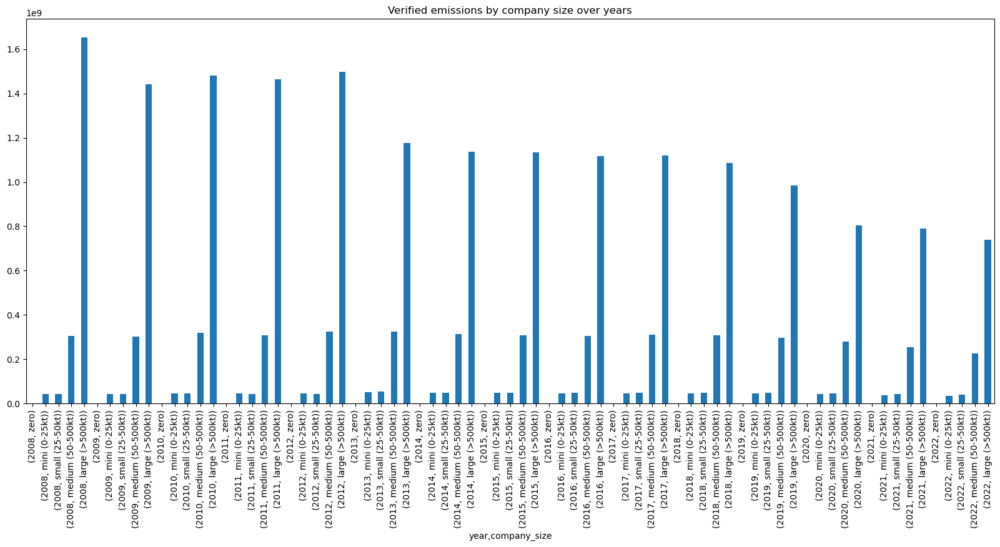

In [12]:
df_free_allowances_melted_eu.groupby(['year', 'company_size'])['VERIFIED_EMISSIONS_'].sum().plot(kind='bar', figsize=(20,8), title='Verified emissions by company size over years')

In [13]:
# plotly boxplot of COVERED_EMISSIONS by company size and year
fig = px.box(df_free_allowances_melted_eu, x="year", y="COVERED_EMISSIONS", color='company_size', title='Covered emissions by company size and year')
fig.show()

c:\Users\Alina\anaconda3\envs\modsim\Lib\site-packages\plotly\express\_core.py:1958: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



C:\Users\Alina\AppData\Local\Temp\ipykernel_19644\2678103146.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<Axes: title={'center': 'Mean covered emissions by company size and year'}, xlabel='year,company_size'>

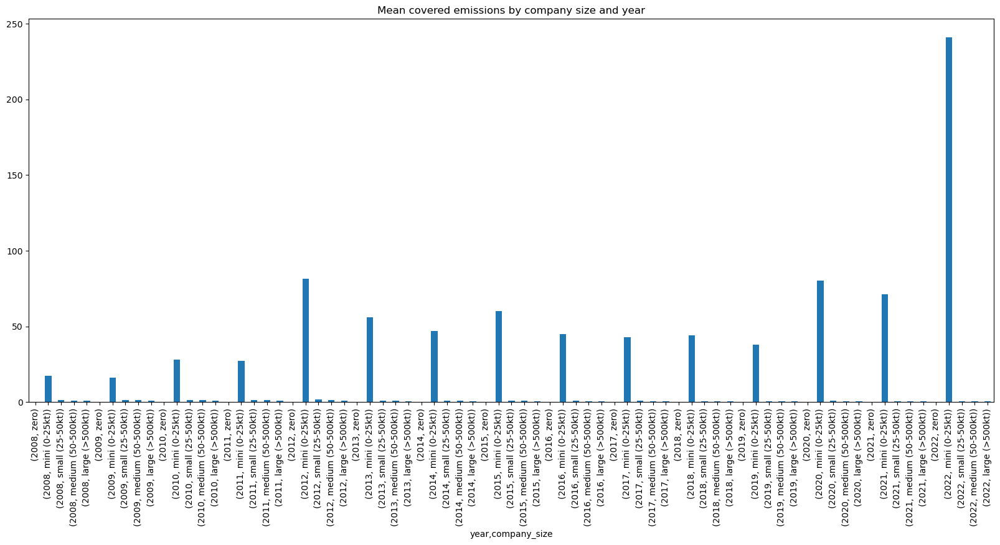

In [14]:
df_free_allowances_melted_eu.groupby(['year', 'company_size'])['COVERED_EMISSIONS'].mean().plot(kind='bar', figsize=(20,8), title='Mean covered emissions by company size and year')

C:\Users\Alina\AppData\Local\Temp\ipykernel_19644\1242605380.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<Axes: title={'center': 'Median covered emissions by company size and year'}, xlabel='year,company_size'>

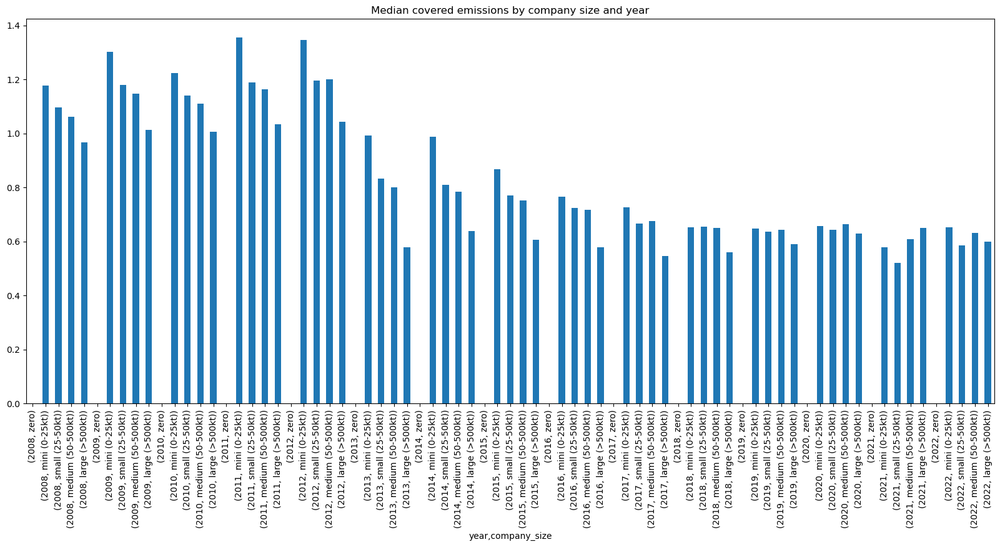

In [15]:
df_free_allowances_melted_eu.groupby(['year', 'company_size'])['COVERED_EMISSIONS'].median().plot(kind='bar', figsize=(20,8), title='Median covered emissions by company size and year')

In [16]:
df_free_allowances_melted_eu[df_free_allowances_melted_eu.company_size=='mini (0-25kt)'][['INSTALLATION_NAME', 'ALLOCATION_', 'VERIFIED_EMISSIONS_', 'COVERED_EMISSIONS']].sort_values(by='COVERED_EMISSIONS', ascending=False).head()

,INSTALLATION_NAME,ALLOCATION_,VERIFIED_EMISSIONS_,COVERED_EMISSIONS
112567,BioMethanol Chemie Nederland B.V.,693307.0,1.0,693307.0
33645,Rhein Papier Hürth,97139.0,1.0,97139.0
33644,Rhein Papier Hürth,95453.0,1.0,95453.0
33643,Rhein Papier Hürth,93746.0,1.0,93746.0
33642,Rhein Papier Hürth,92021.0,1.0,92021.0


Divide the companies into 10 quantile-based bins of equal length based on verified emissions percent (of the market in a specific year):

In [17]:
# bin df_free_allowances_melted_eu by VERIFIED_EMISSION_PERCENT into 10 groups so that each bin contains 10% of the data
df_free_allowances_melted_eu['VERIFIED_EMISSIONS_PERCENT_BIN'] = pd.qcut(df_free_allowances_melted_eu['VERIFIED_EMISSIONS_PERCENT'], q=10, labels=[f'{i}0-{i+1}0%' for i in range(10)])

In [18]:
df_free_allowances_melted_eu.groupby('VERIFIED_EMISSIONS_PERCENT_BIN').INSTALLATION_NAME.count()

C:\Users\Alina\AppData\Local\Temp\ipykernel_19644\237304992.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



VERIFIED_EMISSIONS_PERCENT_BIN
00-10%     14358
10-20%     14359
20-30%     14356
30-40%     14358
40-50%     14357
50-60%     14358
60-70%     14357
70-80%     14358
80-90%     14357
90-100%    14358
Name: INSTALLATION_NAME, dtype: int64

c:\Users\Alina\anaconda3\envs\modsim\Lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning:

invalid value encountered in subtract



Text(0.5, 1.0, 'Mean covered emissions by verified emissions size (quantile-binned) and year')

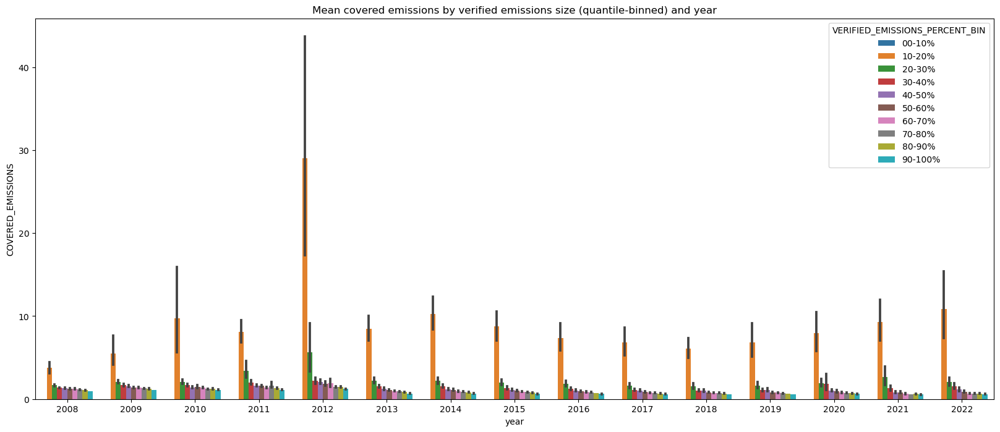

In [19]:
_, ax = plt.subplots(figsize=(20,8))
sns.barplot(data=df_free_allowances_melted_eu, x='year', y='COVERED_EMISSIONS', hue='VERIFIED_EMISSIONS_PERCENT_BIN', ax=ax)
ax.set_title('Mean covered emissions by verified emissions size (quantile-binned) and year')

Need for the initialization:
- verified emissions
- allocation
- find companies which have the biggest % of the market
- how many % of emissions of the big companies are allocated for free - is there correlation with the size? are bigger companies compensated more than smaller and middle companies? are there differences in % of allocations depending on the company size? ANSWER: smaller companies actually get more allowances covered than big ones
- allowance cap from year to year in the whole market
- allocated % of the market cap
- average price per year
- difference between sectors over different countries - are some countries "greener" than others?


European Environment Agency categorizes companies as:
- large (>500kt CO2)
- medium (50-500kt CO2)
- small (25-50kt CO2)
- mini (0-25kt CO2)
- zero (0kt CO2)

need to check the proportion allocation vs total emissions across EEA sizes categorization